# Notebook Setup

In [1]:
from __future__ import print_function
from google.colab import auth
from google.cloud import bigquery
from google.cloud.bigquery import magics
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go

In [2]:
auth.authenticate_user()

In [3]:
#@title Fill out this form then press [shift ⇧]+[enter ⏎] {run: "auto"}
import subprocess
import re

analysis_project = 'mimic-iv-2022bv9'  #@param {type:"string"}

admissions_table = 'physionet-data.mimic_core.admissions'  # @param {type: "string"}
d_icd_diagnoses_table = 'physionet-data.mimic_hosp.d_icd_diagnoses'  # @param {type: "string"}
diagnoses_icd_table = 'physionet-data.mimic_hosp.diagnoses_icd'  # @param {type: "string"}
patients_table = 'physionet-data.mimic_core.patients'  # @param {type: "string"}
labevents_table = 'physionet-data.mimic_hosp.labevents'  # @param {type: "string"}
d_labitems = 'physionet-data.mimic_hosp.d_labitems'  # @param {type: "string"}
procedures_icd_table = 'physionet-data.mimic_hosp.procedures_icd'  # @param {type: "string"}
d_icd_procedures_table = 'physionet-data.mimic_hosp.d_icd_procedures'  # @param {type: "string"}


# Preprocess queries made with the %%bigquery magic
# by substituting these values
sub_dict = {
    'analysis_project': analysis_project,
    'admissions_table': admissions_table,
    'd_icd_diagnoses_table': d_icd_diagnoses_table,
    'diagnoses_icd_table': diagnoses_icd_table,
    'patients_table': patients_table,
    'labevents_table': labevents_table,
    'd_labitems': d_labitems,
    'procedures_icd_table' : procedures_icd_table,
    'd_icd_procedures_table': d_icd_procedures_table,
    'ml_table_prefix': analysis_project + '.MIMIC.models_'
}

# Set the default project for running queries
magics.context.project = analysis_project

In [4]:
# Set up the substitution preprocessing injection
original_run_query = magics._run_query
def format_and_run_query(client, query, job_config=None):
  query = query.format(**sub_dict)
  #return original_run_query(client, query, job_config)
  return original_run_query(client, query, job_config)

#bigquery.magics._run_query = format_and_run_query
magics._run_query = format_and_run_query

print('analysis_project:', analysis_project)
print()
print('custom %%bigquery magic substitutions:')
for k, v in sub_dict.items():
  print(' ', '{%s}' % k, '→', v)

analysis_project: mimic-iv-2022bv9

custom %%bigquery magic substitutions:
  {analysis_project} → mimic-iv-2022bv9
  {admissions_table} → physionet-data.mimic_core.admissions
  {d_icd_diagnoses_table} → physionet-data.mimic_hosp.d_icd_diagnoses
  {diagnoses_icd_table} → physionet-data.mimic_hosp.diagnoses_icd
  {patients_table} → physionet-data.mimic_core.patients
  {labevents_table} → physionet-data.mimic_hosp.labevents
  {d_labitems} → physionet-data.mimic_hosp.d_labitems
  {procedures_icd_table} → physionet-data.mimic_hosp.procedures_icd
  {d_icd_procedures_table} → physionet-data.mimic_hosp.d_icd_procedures
  {ml_table_prefix} → mimic-iv-2022bv9.MIMIC.models_


In [5]:
%config InlineBackend.figure_format = 'svg'

In [6]:
bq = bigquery.Client(project=analysis_project)

In [7]:
if 'MIMIC' not in [d.dataset_id for d in list(bq.list_datasets())]:
  dataset_id = "{}.MIMIC".format(bq.project)
  # Construct a full Dataset object to send to the API.
  # Send the dataset to the API for creation.
  # Raises google.api_core.exceptions.Conflict if the Dataset already
  # exists within the project.

  dataset = bigquery.Dataset(dataset_id)
  dataset = bq.create_dataset(dataset)  # Make an API request.

# K-means MODEL

Get 40 most common labs based on the last assignment. I did the selection before calculating the lab results of only the first 4 hours, becuase the assignment tells to use the selection from the last assignment (And in the previous assignment I used all the data).

In [8]:
%%bigquery top_labs
WITH top_lab AS (
  SELECT itemid, COUNT(*) AS count FROM `{labevents_table}`
  GROUP BY itemid
)
SELECT top_lab.itemid, top_lab.count FROM top_lab 
ORDER BY count DESC LIMIT 50

In [9]:
lab_columns = list()
for _, row in top_labs.iloc[:40].iterrows():
  lab_columns.append('MAX(IF(itemid = {0}, VALUE, "-1"))'
                            ' as `itemid_{0}`'.format(row.itemid))

In [ ]:
query_jobs_new = list()
query = """ 
CREATE OR REPLACE MODEL `{ml_table_prefix}kmeans_data`
OPTIONS(model_type='kmeans', kmeans_init_method ='KMEANS++', num_clusters=4, standardize_features = true)
AS
WITH labs AS (
  SELECT 
    a.HADM_ID,
    {lab_cols},
  FROM 
    `{labevents_table}` AS l
  JOIN 
    `{admissions_table}` as a
  ON 
    l.HADM_ID = a.HADM_ID
  WHERE 
    itemid IS NOT NULL
  AND (
    DATE_DIFF(l.charttime, a.admittime, minute) <= 4 * 60
  AND 
    DATE_DIFF(l.charttime, a.admittime, minute) >= 0
  )
  GROUP BY HADM_ID
)

SELECT
  labs.* EXCEPT (HADM_ID),
  patients.gender,
  patients.anchor_age,
  adm.admission_type,
  adm.admission_location,
  adm.insurance,
  adm.marital_status,
  adm.ethnicity,

FROM 
  `{admissions_table}` AS adm
  LEFT JOIN `{patients_table}` AS patients USING (SUBJECT_ID)
  LEFT JOIN labs USING (HADM_ID)

""".format(lab_cols=',\n    '.join(lab_columns), **sub_dict)
# Run the query, and track its progress with query_jobs
query_jobs_new.append(bq.query(query))

# Wait for all of the models to finish training
for j in query_jobs_new:
  j.exception()

In [ ]:
predict_query = """ 
WITH labs AS (
  SELECT 
    l.HADM_ID,
    {lab_cols},
  FROM 
    `{labevents_table}` AS l
  JOIN 
    `{admissions_table}` as a
  ON 
    l.HADM_ID = a.HADM_ID
  WHERE 
    itemid IS NOT NULL
  AND (
    DATE_DIFF(l.charttime, a.admittime, minute) <= 4 * 60
  AND 
    DATE_DIFF(l.charttime, a.admittime, minute) >= 0
  )
  GROUP BY HADM_ID
),
admissions_data  as (
  SELECT
    labs.*,
    patients.gender,
    patients.anchor_age,
    adm.admission_type,
    adm.admission_location,
    adm.insurance,
    adm.marital_status,
    adm.ethnicity,
    adm.HOSPITAL_EXPIRE_FLAG as died,
  FROM 
    `{admissions_table}` AS adm
    LEFT JOIN `{patients_table}` AS patients USING (SUBJECT_ID)
    LEFT JOIN labs USING (HADM_ID)
)

SELECT 
  * EXCEPT(nearest_centroids_distance)
FROM
  ML.PREDICT( MODEL `{ml_table_prefix}kmeans_data`,
    (
    SELECT
      *
    FROM
      admissions_data
      ))

""".format(lab_cols=',\n    '.join(lab_columns), **sub_dict)
# Run the query, and track its progress with query_jobs
bq_response  = bq.query(predict_query).to_dataframe()

# Description of the results

Distributions of demographic data

In [16]:
bq_response

,CENTROID_ID,HADM_ID,itemid_51221,itemid_50912,itemid_51265,itemid_51222,itemid_51301,itemid_51006,itemid_51249,itemid_51279,...,itemid_51486,itemid_51506,gender,anchor_age,admission_type,admission_location,insurance,marital_status,ethnicity,died
0,1,27047778.0,46.7,0.8,286,16.5,10.7,14,35.2,5.21,...,-1,-1,M,39,EW EMER.,EMERGENCY ROOM,Other,SINGLE,WHITE,0
1,1,25135035.0,-1,3.2,-1,-1,-1,45,-1,-1,...,-1,-1,M,53,EW EMER.,EMERGENCY ROOM,Other,SINGLE,WHITE,0
2,1,21758878.0,-1,1.1,-1,-1,-1,30,-1,-1,...,-1,-1,M,72,EW EMER.,EMERGENCY ROOM,Medicare,MARRIED,WHITE,0
3,1,22299973.0,28.9,4.3,-1,-1,-1,56,-1,-1,...,-1,-1,F,86,EW EMER.,EMERGENCY ROOM,Medicare,MARRIED,WHITE,0
4,1,27536444.0,-1,2.0,-1,-1,-1,28,-1,-1,...,-1,-1,M,45,EW EMER.,EMERGENCY ROOM,Other,SINGLE,WHITE,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
523735,4,25449540,26.1,3.9,247,7.6,6.6,110,29.1,3.48,...,-1,-1,M,82,DIRECT EMER.,PHYSICIAN REFERRAL,Other,MARRIED,OTHER,1
523736,4,23772868,41.3,0.8,273,14.2,7.7,12,34.3,4.50,...,-1,-1,F,58,DIRECT EMER.,PHYSICIAN REFERRAL,Medicare,MARRIED,BLACK/AFRICAN AMERICAN,0
523737,4,25333260,34.3,0.7,165,11.5,5.6,27,33.4,3.65,...,-1,-1,F,88,ELECTIVE,PHYSICIAN REFERRAL,Medicare,WIDOWED,WHITE,0
523738,4,21657049,27.4,1.6,373,8.4,16.5,34,30.6,3.19,...,-1,-1,F,91,EW EMER.,EMERGENCY ROOM,Medicare,None,UNKNOWN,1


In [51]:
# fill na for visualization
bq_response_wout_na = bq_response.fillna('UNKNOWN')
bq_response_wout_na.isna().sum()

CENTROID_ID           0
HADM_ID               0
itemid_51221          0
itemid_50912          0
itemid_51265          0
itemid_51222          0
itemid_51301          0
itemid_51006          0
itemid_51249          0
itemid_51279          0
itemid_51250          0
itemid_51248          0
itemid_51277          0
itemid_50971          0
itemid_50983          0
itemid_50902          0
itemid_50882          0
itemid_50868          0
itemid_50931          0
itemid_50893          0
itemid_50960          0
itemid_50970          0
itemid_50934          0
itemid_51678          0
itemid_50947          0
itemid_51237          0
itemid_51274          0
itemid_50920          0
itemid_50861          0
itemid_52172          0
itemid_50878          0
itemid_51275          0
itemid_50885          0
itemid_51244          0
itemid_51256          0
itemid_51254          0
itemid_51146          0
itemid_51200          0
itemid_50863          0
itemid_50862          0
itemid_51486          0
itemid_51506    

Age Distribution

In [30]:
integer_features = ['anchor_age']

for i in integer_features:
  fig = px.box(bq_response, x="CENTROID_ID", y="anchor_age", color='CENTROID_ID', labels={
                     "anchor_age": "Age",
                     "CENTROID_ID": "Cluster Number",
                 },
               title='Distribution of age for each cluster')
  fig.show()

Categorical features Distribution

In [33]:
categorical_features = ['gender', 'admission_type', 'admission_location', 'insurance', 'marital_status', 'ethnicity']

for c in categorical_features:
  print(f"feature {c} has {len(bq_response[c].unique())} unique values")

feature gender has 2 unique values
feature admission_type has 9 unique values
feature admission_location has 12 unique values
feature insurance has 3 unique values
feature marital_status has 5 unique values
feature ethnicity has 8 unique values


In [63]:
def plot_cat_dist(c):
  """
  Plot categorical features distribution using histogram.
  c (string): categorical feature name
  """
  fig = px.histogram(bq_response_wout_na, x=c, facet_col='CENTROID_ID', color=c, title=f'Distribution of {c} for each cluster')
  fig.update_yaxes(matches=None, showticklabels=True)
  fig.show()

In [126]:
def plot_heatmap(c):
  """
  Plot heatmap with percents of each feature value in each cluster.
  c (string): categorical feature name
  """
  pivot = pd.pivot_table(bq_response_wout_na, index = ['CENTROID_ID', c], aggfunc='count').loc[:, ['HADM_ID']].rename(columns = {'HADM_ID': 'count'})
  pivot['Percent'] = (pivot["count"] / pivot.groupby(level=0)["count"].transform(sum) * 100)
  pivot = pivot.loc[:, ['Percent']].reset_index()
  pivot = pd.pivot_table(pivot, values='Percent', index='CENTROID_ID', columns = c)
  display(pivot)
  sns.heatmap(pivot, cmap="YlGnBu")

Gender Distribution

In [57]:
plot_cat_dist('gender')

gender,F,M
CENTROID_ID,,
1,50.182025,49.817975
2,52.381868,47.618132
3,54.083373,45.916627
4,44.219055,55.780945


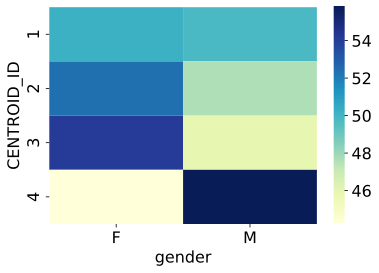

In [127]:
plot_heatmap('gender')

Admimssion Type Distribution

In [58]:
plot_cat_dist('admission_type')

admission_type,AMBULATORY OBSERVATION,DIRECT EMER.,DIRECT OBSERVATION,ELECTIVE,EU OBSERVATION,EW EMER.,OBSERVATION ADMIT,SURGICAL SAME DAY ADMISSION,URGENT
CENTROID_ID,,,,,,,,,
1,0.841866,3.981797,2.161547,1.058020,7.508532,64.539249,12.696246,2.730375,4.482366
2,1.608392,2.660090,4.032967,13.774725,23.521978,29.374875,10.291459,8.556194,6.179321
3,0.592136,3.304911,2.209064,21.236381,6.699826,31.517448,10.506869,8.193589,15.739776
4,0.712612,16.569699,4.400625,6.591175,2.655213,28.594299,12.729403,2.705974,25.041000


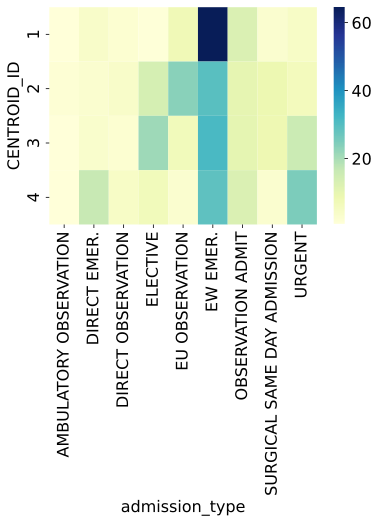

In [128]:
plot_heatmap('admission_type')

Admission Location Distribution

In [59]:
plot_cat_dist('admission_location')

admission_location,AMBULATORY SURGERY TRANSFER,CLINIC REFERRAL,EMERGENCY ROOM,INFORMATION NOT AVAILABLE,INTERNAL TRANSFER TO OR FROM PSYCH,PACU,PHYSICIAN REFERRAL,PROCEDURE SITE,TRANSFER FROM HOSPITAL,TRANSFER FROM SKILLED NURSING FACILITY,UNKNOWN,WALK-IN/SELF REFERRAL
CENTROID_ID,,,,,,,,,,,,
1,0.022753,2.480091,70.762230,0.102389,0.375427,0.875995,13.651877,2.081911,5.824801,0.932878,0.056883,2.832765
2,0.034466,1.558442,50.080420,0.055694,1.034715,1.363387,22.695554,1.591908,5.300200,0.756743,12.019231,3.509241
3,0.028423,1.785883,38.973630,0.053687,0.255803,0.363177,30.142113,1.316911,4.849203,0.704248,19.291015,2.235907
4,0.064428,6.015228,27.957829,0.220617,0.251855,0.587661,31.885982,2.065599,27.950020,0.985943,0.171808,1.843030


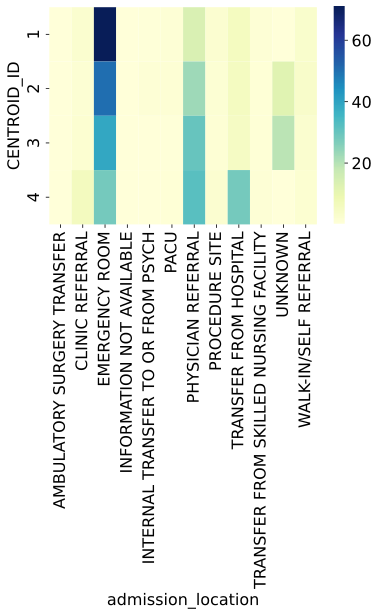

In [129]:
plot_heatmap('admission_location')

Insurance Distribution

In [60]:
plot_cat_dist('insurance')

insurance,Medicaid,Medicare,Other
CENTROID_ID,,,
1,9.510808,43.538111,46.951081
2,9.947303,31.864136,58.188561
3,9.838939,28.525186,61.635876
4,7.719641,42.725498,49.554861


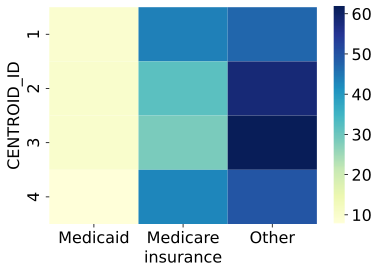

In [130]:
plot_heatmap('insurance')

Marital Status Distribution

In [61]:
plot_cat_dist('marital_status')

marital_status,DIVORCED,MARRIED,SINGLE,UNKNOWN,WIDOWED
CENTROID_ID,,,,,
1,7.258248,40.182025,36.120592,3.265074,13.174061
2,6.504246,35.835415,35.936813,12.553197,9.170330
3,5.180799,38.413074,28.280436,19.696826,8.428865
4,7.315502,46.431082,29.316673,6.019133,10.917610


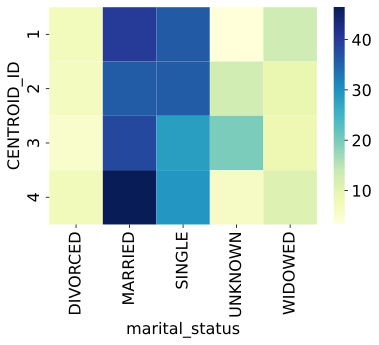

In [131]:
plot_heatmap('marital_status')

Ethnicity Distribution

In [62]:
plot_cat_dist('ethnicity')

ethnicity,AMERICAN INDIAN/ALASKA NATIVE,ASIAN,BLACK/AFRICAN AMERICAN,HISPANIC/LATINO,OTHER,UNABLE TO OBTAIN,UNKNOWN,WHITE
CENTROID_ID,,,,,,,,
1,0.307167,3.629124,18.737201,5.506257,3.936291,0.477816,2.912400,64.493743
2,0.278971,4.683816,15.955794,5.919081,5.088162,0.623626,3.078172,64.372378
3,0.437391,6.368230,15.198168,5.622928,5.766619,0.950576,4.457603,61.198484
4,0.222569,2.733307,10.023428,4.057009,4.767669,1.169465,7.801640,69.224912


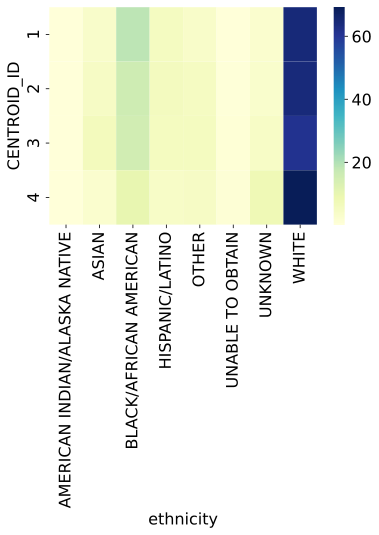

In [132]:
plot_heatmap('ethnicity')

Death probability of each cluster and the overall probability of death

In [54]:
cluster_1 = bq_response[(bq_response['CENTROID_ID'] == 1) & (bq_response['died'] == 1)].shape[0] / bq_response[bq_response['CENTROID_ID'] == 1].shape[0]
cluster_2 = bq_response[(bq_response['CENTROID_ID'] == 2) & (bq_response['died'] == 1)].shape[0] / bq_response[bq_response['CENTROID_ID'] == 2].shape[0]
cluster_3 = bq_response[(bq_response['CENTROID_ID'] == 3) & (bq_response['died'] == 1)].shape[0] / bq_response[bq_response['CENTROID_ID'] == 3].shape[0]
cluster_4 = bq_response[(bq_response['CENTROID_ID'] == 4) & (bq_response['died'] == 1)].shape[0] / bq_response[bq_response['CENTROID_ID'] == 4].shape[0]
overall = bq_response[bq_response['died'] == 1].shape[0] / bq_response.shape[0]

death_prob_dict = {"Cluster_1 prob" : [cluster_1], "Cluster_2 prob" : [cluster_2], "Cluster_3 prob" : [cluster_3], "Cluster_4 prob" : [cluster_4], "Overall prob" : overall}
death_prob_df = pd.DataFrame(death_prob_dict)
death_prob_df

,Cluster_1 prob,Cluster_2 prob,Cluster_3 prob,Cluster_4 prob,Overall prob
0,0.041638,0.010542,0.023006,0.064545,0.017852


# Clinical Decision Support System (CDSS)

In [ ]:
%%bigquery diagnoses
SELECT HADM_ID, icd_code
FROM `{admissions_table}`
LEFT JOIN `{diagnoses_icd_table}` USING(HADM_ID) 

In [ ]:
%%bigquery adm_procedure
SELECT HADM_ID, icd_code
FROM `{admissions_table}`
LEFT JOIN `{procedures_icd_table}` USING(HADM_ID) 

**Cluster 1**

I can see that in the first cluster, 64.5% of admission types are EW EMER., while the other clusters have approximately 30% of this type. In addition, 70% of the admission locations are EMERGENCY ROOM, while in the other clusters less than 50% were in this location. Hence, we can use this to give an appropriate procedure to a patient which has this feature values. The other features do not seem to have significant impace on this cluster. The next code finding the top common procedure for the first clutser, and based on it I will suggest a procedure that seems relevant.

In [34]:
# get the top procedures and diagnosis of the first cluster
top_diag_cluster_1 = tuple(diagnoses[diagnoses["HADM_ID"].isin(list(bq_response[bq_response['CENTROID_ID'] == 1]["HADM_ID"]))]["icd_code"].value_counts()[:3].index)
top_proc_cluster_1 = tuple(adm_procedure[adm_procedure["HADM_ID"].isin(list(bq_response[bq_response['CENTROID_ID'] == 1]["HADM_ID"]))]["icd_code"].value_counts()[:3].index)

In [41]:
# get the title of diagnosis by the icd code
cluster_1_diag_query = """
    SELECT long_title 
    FROM `{d_icd_diagnoses_table}`
    WHERE icd_code in {top_diag_cluster_1}
""".format(top_diag_cluster_1 = top_diag_cluster_1, **sub_dict)
bq_response_diag_1  = bq.query(cluster_1_diag_query).to_dataframe()
bq_response_diag_1

,long_title
0,Other and unspecified hyperlipidemia
1,Unspecified essential hypertension
2,"Acute kidney failure, unspecified"


In [42]:
# get the title of procedure by the icd code
cluster_1_proc_query = """
    SELECT long_title 
    FROM `{d_icd_procedures_table}`
    WHERE icd_code in {top_procedures}
""".format(top_procedures = top_proc_cluster_1, **sub_dict)
bq_response_proc_1  = bq.query(cluster_1_proc_query).to_dataframe()
bq_response_proc_1

,long_title
0,"Venous catheterization, not elsewhere classified"
1,Central venous catheter placement with guidance
2,Continuous invasive mechanical ventilation for...


So we can suggest to patients who follow the requirements of the first cluster (as mentioned before) to have one of the given top procedures, for examples Venous catheterization and their diagnosis could be Acute kidney failure.

**Cluster 2**

It is very hard to find unqiue characteristics to cluster number 2, but it seems that if the admission type is EU OBSERVATION it could be relate to this cluster because 23.5% of this admission type are related to this cluster and the next cluster which has this admission type has only 7.5%. Because this cluster is hard to guess I won't suggest procedure/diagnoses.

**Cluster 3**

I can see that this is the only cluster which contains the ages betwee 25-33 in the first quartile. Moreover, 21.2% of the admission types are elective while the next possible cluster has only 13% of this admission type. Therefore there is more chance to use common procedures in this cluster on patient with this features. 

In [57]:
# get the top procedures and diagnosis of the first cluster
top_diag_cluster_3 = tuple(diagnoses[diagnoses["HADM_ID"].isin(list(bq_response[bq_response['CENTROID_ID'] == 3]["HADM_ID"]))]["icd_code"].value_counts()[:3].index)
top_proc_cluster_3 = tuple(adm_procedure[adm_procedure["HADM_ID"].isin(list(bq_response[bq_response['CENTROID_ID'] == 3]["HADM_ID"]))]["icd_code"].value_counts()[:3].index)

In [ ]:
# get the title of diagnosis by the icd code
cluster_3_diag_query = """
    SELECT long_title 
    FROM `{d_icd_diagnoses_table}`
    WHERE icd_code in {top_diagnoses}
""".format(top_diagnoses = top_diag_cluster_3, **sub_dict)
bq_response_diag_3  = bq.query(cluster_3_diag_query).to_dataframe()
bq_response_diag_3

In [ ]:
# get the title of procedure by the icd code
cluster_3_proc_query = """
    SELECT long_title 
    FROM `{d_icd_procedures_table}`
    WHERE icd_code in {top_procedures}
""".format(top_procedures = top_proc_cluster_3, **sub_dict)
bq_response_proc_3  = bq.query(cluster_3_proc_query).to_dataframe()
bq_response_proc_3

**Cluster 4**

In this cluster we can see that patients that their admission location is TRANSFER FROM HOSPITAL are more related to this cluster with 27% of the admission in this cluster have this value (while the next highest is only 5%), and also 16.6% of the admissions have DIRECT EMER admission type compared to 3.9% the second highest, and 
admission type direct emer 16.6% 3.9 urgent 25 15

In [ ]:
# get the top procedures and diagnosis of the first cluster
top_diag_cluster_4 = tuple(diagnoses[diagnoses["HADM_ID"].isin(list(bq_response[bq_response['CENTROID_ID'] == 4]["HADM_ID"]))]["icd_code"].value_counts()[:3].index)
top_proc_cluster_4 = tuple(adm_procedure[adm_procedure["HADM_ID"].isin(list(bq_response[bq_response['CENTROID_ID'] == 4]["HADM_ID"]))]["icd_code"].value_counts()[:3].index)

In [ ]:
# get the title of diagnosis by the icd code
cluster_4_diag_query = """
    SELECT long_title 
    FROM `{d_icd_diagnoses_table}`
    WHERE icd_code in {top_diagnoses}
""".format(top_diagnoses = top_diag_cluster_4, **sub_dict)
bq_response_diag_4  = bq.query(cluster_4_diag_query).to_dataframe()
bq_response_diag_4

In [ ]:
# get the title of procedure by the icd code
cluster_4_proc_query = """
    SELECT long_title 
    FROM `{d_icd_procedures_table}`
    WHERE icd_code in {top_procedures}
""".format(top_procedures = top_proc_cluster_4, **sub_dict)
bq_response_proc_4 = bq.query(cluster_4_proc_query).to_dataframe()
bq_response_proc_4

# Note: google cloud stopped responding becuase too many requests, hence I couldn't find the name of diagnoses and procedures for clusters 3-4. But the operation is the same as cluster 1 - find the top procedures/diagnosis for each cluster and suggest them. 
